# PROJECT PROPOSAL


## Introduction
This proposal focuses on exploring three important factors, distance from the city center, distance from the nearest metro station, and the number of bedrooms—as they relate to Airbnb pricing. In many urban areas, properties closer to key attractions and major transit hubs can command higher rates; likewise, properties with more bedrooms can often accommodate larger groups at premium prices.

## Research Question
"**How do distance from the city center, distance from the nearest metro station, and the number of bedrooms affect the price of Airbnb listings in London, Rome, and Budapest?**"

Since we are interested in understanding how distance and number of bedrooms influence price, the primary focus would be an inference question, though we can also build a mdel that can predict prices. 

## Data Description

This dataset provides a comprehensive look at Airbnb prices in some of the most popular European cities. It contains information on a variety of attributes such as room type, cleanliness rating, guest satisfaction, distance from the city centre, and more. In addition to exploring general trends in prices across Europe, this dataset can be used for deeper spatial econometric analysis.

There are 15 variables and 23042 observations in total in the data.
 The **key variables** for this proposal include:  
- `realSum`: The total Airbnb listing price (numeric).  This is the response. 
- `dist`: Distance from the city center (numeric).  
- `metro_dist`: Distance from the nearest metro station (numeric).  
- `bedrooms`: The number of bedrooms (numeric).  
- `city`: The city name (categorical: London, Rome, or Budapest).  
- `day_type`: Whether it's a weekday or weekend listing (categorical).
- `cleaniness_rating`: Numeric rating for the cleaniness of the listing.
- `person_capacity`: Number of people the listing can host. 
- `room_type` : type of room being offered(private, shared, etc), categorical
- `host_is_superhost` : whether the host is a superhost or not (boolean), 


Variables dropped: 
- `lng` : Longtitude of the listing
- `lat` : Latitude of the listing
- `biz` :for business purposes or not (boolean).
- `room_shared` : whether the room is shared or not (boolean)
- `room_private` : whether the room is private or not(boolean) 

These 5 variables will be dropped as they offer no significant meaning. Room shared and room private are already determined in room type. 

 
## References
- [Airbnb Prices in European Cities (Kaggle)](https://www.kaggle.com/datasets/thedevastator/airbnb-prices-in-european-cities)  


## Data cleaning and wrangling

In [14]:

library(tidyverse)  
library(ggplot2)    
library(dplyr)      

#london_weekdays <- read.csv("london_weekdays.csv")
#london_weekends <- read.csv("london_weekends.csv")
#rome_weekdays <- read.csv("rome_weekdays.csv")
#rome_weekends <- read.csv("rome_weekends.csv")
#budapest_weekdays <- read.csv("budapest_weekdays.csv")
#budapest_weekends <- read.csv("budapest_weekends.csv")


#london_weekdays$city <- "London"
#london_weekdays$day_type <- "Weekday"

#london_weekends$city <- "London"
#london_weekends$day_type <- "Weekend"

#rome_weekdays$city <- "Rome"
#rome_weekdays$day_type <- "Weekday"

#rome_weekends$city <- "Rome"
#rome_weekends$day_type <- "Weekend"

#budapest_weekdays$city <- "Budapest"
#budapest_weekdays$day_type <- "Weekday"

#budapest_weekends$city <- "Budapest"
#budapest_weekends$day_type <- "Weekend"


bud_wd_url <- "https://raw.githubusercontent.com/picklesnck/project/refs/heads/main/budapest_weekdays.csv"
bud_we_url <- "https://raw.githubusercontent.com/picklesnck/project/refs/heads/main/budapest_weekends.csv"
lon_wd_url <- "https://raw.githubusercontent.com/picklesnck/project/refs/heads/main/london_weekdays.csv"
lon_we_url <- "https://raw.githubusercontent.com/picklesnck/project/refs/heads/main/london_weekends.csv"
rom_wd_url <- "https://raw.githubusercontent.com/picklesnck/project/refs/heads/main/rome_weekdays.csv"
rom_we_url <- "https://raw.githubusercontent.com/picklesnck/project/refs/heads/main/rome_weekends.csv"

budapest_weekdays <- read.csv(bud_wd_url) |>
  mutate(city = "Budapest", weekend = 0)

budapest_weekends <- read.csv(bud_we_url) |>
 mutate(city = "Budapest", weekend = 1)

london_weekdays <- read.csv(lon_wd_url) |>
 mutate(city = "London", weekend = 0)

london_weekdays <- read.csv(lon_we_url) |>
 mutate(city = "London", weekend = 1)

rome_weekdays <- read.csv(rom_wd_url) |>
 mutate(city = "Rome", weekend = 0)

rome_weekdays <- read.csv(rom_wd_url) |>
 mutate(city = "Rome", weekend = 1)


airbnb_data <- bind_rows(
  london_weekdays, london_weekends,
  rome_weekdays, rome_weekends,
  budapest_weekdays, budapest_weekends)

## Data Cleaning

In [15]:

airbnb_data <- airbnb_data %>%
  filter(
    !is.na(realSum),
    !is.na(dist),
    !is.na(metro_dist),
    !is.na(bedrooms))

airbnb_data$city <- as.factor(airbnb_data$city)
airbnb_data$day_type <- as.factor(airbnb_data$day_type)


summary_stats <- airbnb_data |>
  summarize(
    total_listings = n(),
    mean_price = mean(realSum),
    median_price = median(realSum),
    mean_dist = mean(dist),
    median_dist = median(dist),
    mean_metro_dist = mean(metro_dist),
    median_metro_dist = median(metro_dist),
    mean_bedrooms = mean(bedrooms),
    median_bedrooms = median(bedrooms))

summary_stats


airbnb_data |>
  group_by(city) |>
  summarize(
    mean_price = mean(realSum),
    median_price = median(realSum),
    mean_dist = mean(dist),
    mean_metro_dist = mean(metro_dist),
    mean_bedrooms = mean(bedrooms),
    listings_count = n())

total_listings,mean_price,median_price,mean_dist,median_dist,mean_metro_dist,median_metro_dist,mean_bedrooms,median_bedrooms
<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
23807,272.3617,197.8662,3.871607,3.401465,0.8621143,0.5048541,1.16512,1


city,mean_price,median_price,mean_dist,mean_metro_dist,mean_bedrooms,listings_count
<fct>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>
Budapest,176.5135,152.9821,1.872763,0.5440590,1.105669,4022
London,364.3897,268.1154,5.327620,1.0165336,1.133110,10758
Rome,205.3919,182.5918,3.026982,0.8197941,1.229755,9027


## Exploratory Data Analysis and Visualization

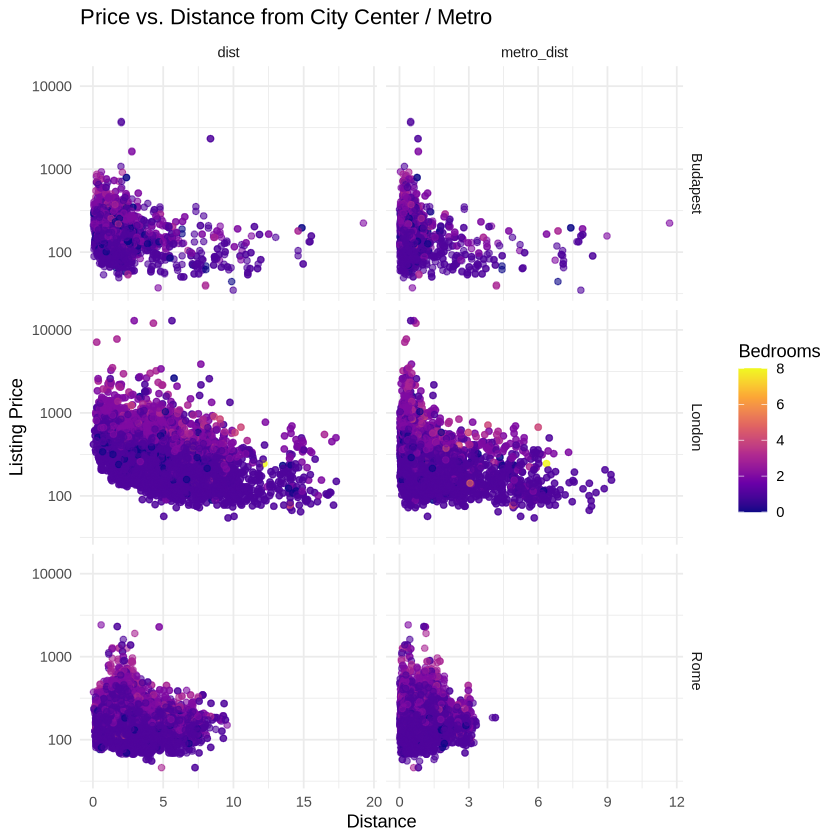

In [16]:

airbnb_data_long <- airbnb_data |>
  select(realSum, dist, metro_dist, city, bedrooms) |>
  mutate(realSum_shifted = if_else(realSum <= 0, 1, realSum)) |>
  pivot_longer(
    cols = c(dist, metro_dist),
    names_to = "DistanceType",
    values_to = "Distance")


ggplot(airbnb_data_long, aes(
  x = Distance,
  y = realSum_shifted,    
  color = bedrooms)) +
  geom_point(alpha = 0.6) +
  facet_grid(city ~ DistanceType, scales = "free_x") +
  scale_color_viridis_c(option = "plasma") +
  scale_y_log10() +        
  labs(
    title = "Price vs. Distance from City Center / Metro ",
    x = "Distance",
    y = "Listing Price",
    color = "Bedrooms") +
  theme_minimal()



## Interpretation

This faceted scatter plot illustrates how Airbnb listing prices vary with distance from the city center and metro station across Budapest, London, and Rome. Each row corresponds to a city, while the columns show distance type (dist vs. metro_dist). We see that higher distances often cluster toward lower- or mid-priced listings, yet some properties near zero distance span a wider range of prices (likely due to other factors like number of bedrooms and other qualities). But overall, a negative trending relationship. 

Still, this plot can be problematic. With so many overlapping points, it becomes difficult to pinpoint exact relationships or identify subtle patterns. Some cities have large clusters that mask underlying variation, and the log scale, while helpful for spread, can obscure just how large certain price differences are in absolute terms. Additional techniques—like jittering or contour plots—might be needed for finer clarity.

# Part 2: Methods and Plan & Computational Code and Output


### Updated Research Question
After reviewing feedback, I have rephrased my question to emphasize **association** rather than causation:  
> **“What is the association between distance from the city center, distance from the nearest metro station, and the number of bedrooms with the total price (`realSum`) of Airbnb listings in London, Rome, and Budapest?”**

### Updated code for reading data
I have also commented out the code I used to read the data in assignment 1 as it read the data locally, and now read the data in from an online url to my git repository. (Code changed in Data cleaning and wrangling) 

###  Updated Visualization with Binned Distances (Violin + Boxplot)
To address overlapping points on a scatter plot, I now use a violin plot (to show the full distribution shape) combined with a boxplot overlay, faceted by city. I also apply a log scale to highlight variation in mid-range prices:

### Proposed Method
I propose using a multiple linear regression (MLR) framework for this question. In an additive MLR model, include separate, linear terms for each predictor—distance from the city center (`dist`), distance from the nearest metro (`metro_dist`), number of bedrooms (`bedrooms`), and city indicators—without including any interaction terms between them. However, if I suspect the effect of, say, distance on price depends on the specific city, I can extend this to an interactive MLR model by adding product terms (e.g., `dist:city`). For now, my focus is on an additive approach where each predictor contributes independently to the listing price association. This approach focuses on inference, not prediction, so splitting data into training and testing sets is not necessary —I want to estimate the relationships within the existing dataset rather than forecast prices for new listings.

### Model Assumptions
1. **Linearity**: A straight-line relationship between each predictor and `realSum` (though log-transforming `realSum` might be beneficial).  
2. **Independence**: Each listing is treated as an independent observation.  
3. **Homoscedasticity & Normality**: Residuals should have constant variance and follow an approximate normal distribution.

### Potential Limitations
- **Observational Data**: I cannot claim cause-and-effect; unmeasured confounders may bias results.  
- **Nonlinearity**: Distance-based variables might need transformations if diagnostic checks suggest curvature.  
- **Omitted Variables**: Factors like host superhost status or seasonality may also influence price but are not in my primary model.


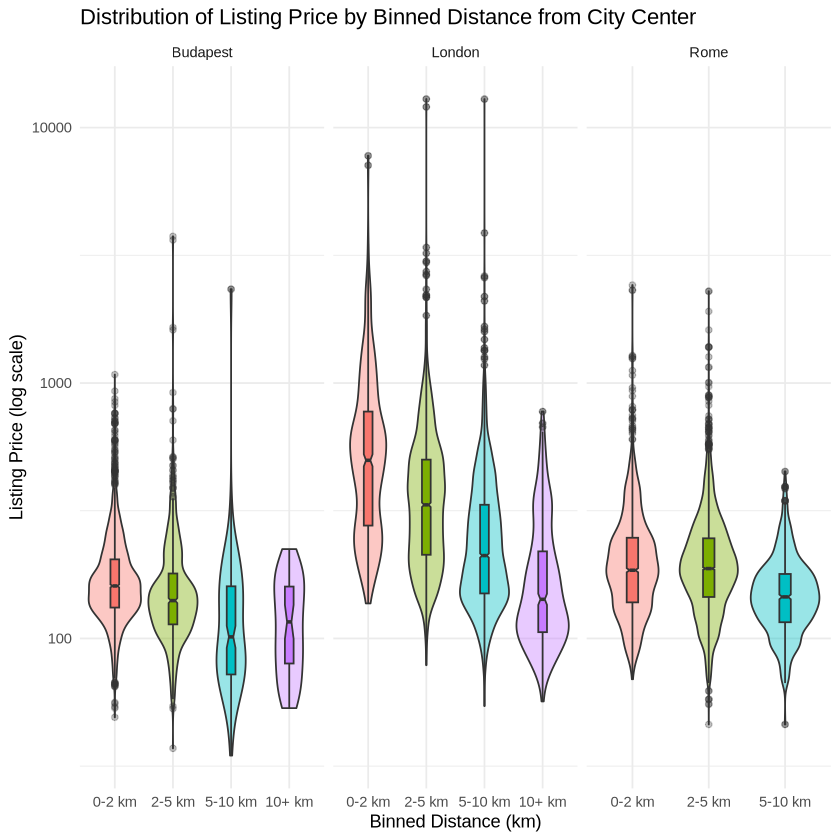

In [17]:
# Create bins for dist (city center) and possibly for metro_dist if needed
airbnb_data_binned <- airbnb_data %>%
  mutate(
    dist_bin = cut(dist,
      breaks = c(0, 2, 5, 10, Inf),
      labels = c("0-2 km","2-5 km","5-10 km","10+ km")
    )
  )

# Combine violin plot + boxplot, facet by city, log-scale on y-axis
ggplot(airbnb_data_binned, aes(x = dist_bin, y = realSum, fill = dist_bin)) +
  geom_violin(alpha = 0.4) +
  geom_boxplot(width = 0.15, outlier.alpha = 0.3, notch = TRUE) +
  facet_wrap(~ city, scales = "free_x") +
  scale_y_log10() +
  labs(
    title = "Distribution of Listing Price by Binned Distance from City Center",
    x = "Binned Distance (km)",
    y = "Listing Price (log scale)"
  ) +
  theme_minimal() +
  theme(legend.position = "none")

# Model building

In [19]:
library(broom)

# Fit an additive multiple linear regression model
mlr_model <- lm(realSum ~ dist + metro_dist + bedrooms + city, data = airbnb_data)

# Tidy table of coefficients
model_coeffs <- tidy(mlr_model)
model_coeffs


term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),68.277115,5.955362,11.464814,2.381134e-30
dist,-28.922285,1.105937,-26.151835,1.182085e-148
metro_dist,-3.570511,2.457536,-1.452882,1.462696e-01
bedrooms,148.637263,3.210399,46.298688,0.000000e+00
cityLondon,285.406715,6.215565,45.918067,0.000000e+00
cityRome,44.801700,5.569976,8.043428,9.140210e-16



## Brief Interpretation 
The table shows how each unit increase in dist, metro_dist, or bedrooms associates with changes in realSum (holding other variables constant) for each city’s baseline. From the table, the coefficient for `dist` is approximately -28.92, suggesting that each additional kilometer from the city center is associated with a \$28.92 lower listing price, on average, holding other factors constant. Meanwhile, `bedrooms` has a positive coefficient of roughly 148.64, indicating each extra bedroom is linked to a higher price by about \$148.64, all else equal. The large coefficients for `cityLondon` (285.41) and `cityRome` (44.80) imply higher baseline prices compared to the reference city (Budapest). 